In [17]:
import numpy as np
import h5py
from IPython.display import Image
import pandas as pd

import matplotlib
from matplotlib import pylab
%config InlineBackend.figure_format = 'retina'
matplotlib.rcParams['figure.dpi'] = 200
params = {'legend.fontsize': 'large',
          'figure.figsize': (8, 8),
         'axes.labelsize': 'x-large',
         'axes.titlesize': 'x-large',
         'xtick.labelsize': 'large',
         'ytick.labelsize': 'large'}
pylab.rcParams.update(params)
from matplotlib import pyplot as plt
%matplotlib inline

%load_ext autoreload
%autoreload 2

import sys
sys.path.insert(1, '/home/ksf293/anomalies-GAN-HSC/analysis')
import plotter
import utils

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
base_dir = '/scratch/ksf293/anomalies'
#plot_dir = '/home/ksf293/anomalies-GAN-HSC/plots/plots_2021-02-14'
plot_dir = '/home/ksf293/anomalies-GAN-HSC/papers/paper_main/images'

In [3]:
imtag = 'gri'
tag = 'gri_lambda0.3'
imarr_fn = f'{base_dir}/data/images_h5/images_{imtag}.h5'
imarr = h5py.File(imarr_fn, 'r')
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')

In [4]:
gen_scores = res['gen_scores_sigma'][:]
disc_scores = res['disc_scores_sigma'][:]
scores = res['anomaly_scores_sigma'][:]
idxs = res['idxs'][:]
print(len(idxs))

942781


## Effect of s_gen and s_disc

In [17]:
nrows = 4
ncols = 4
nplot = nrows*ncols

11893


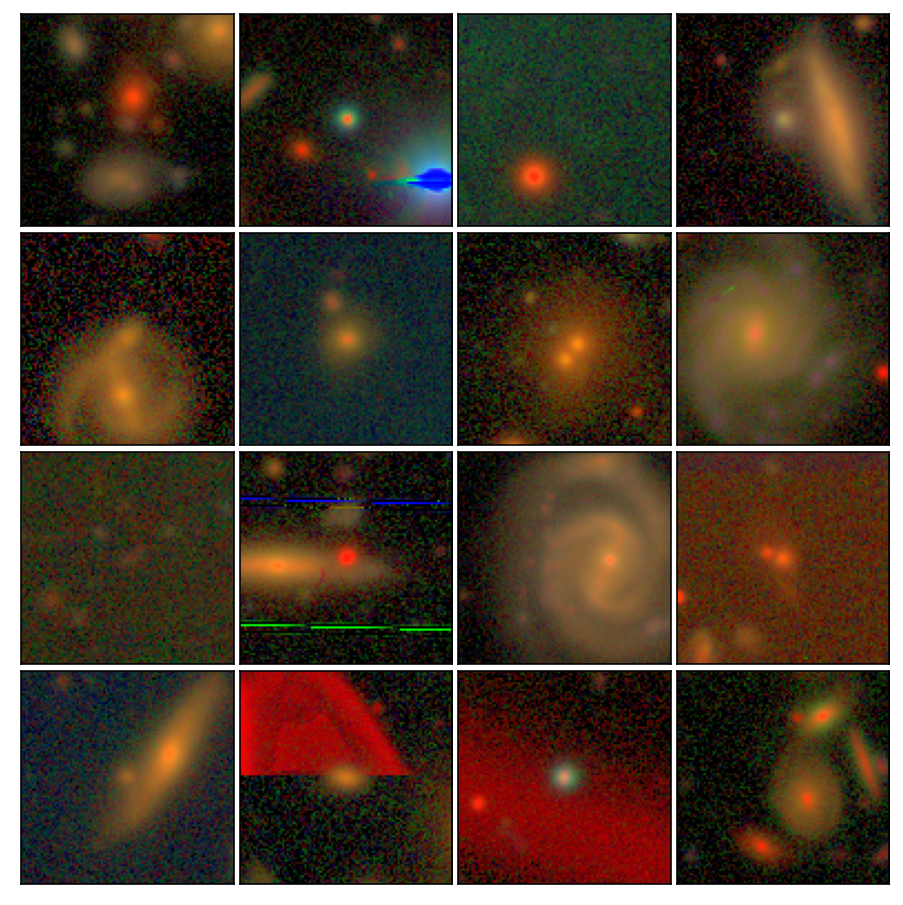

In [60]:
locs = np.where((disc_scores > gen_scores) & (disc_scores > 3))[0]
idxs_sub = [idxs[loc] for loc in locs]
print(len(idxs_sub))
np.random.seed(8) #18, 21, 7, 8
idxs_sub = np.random.choice(idxs_sub, nplot, replace=False)
saveto = f'{plot_dir}/score_effect_3sigdisc_discgreater.png'
plotter.plot_ims(idxs_sub, nrows, ncols, tight=True, hspace=0.032, wspace=-0.08, saveto=saveto)

1584


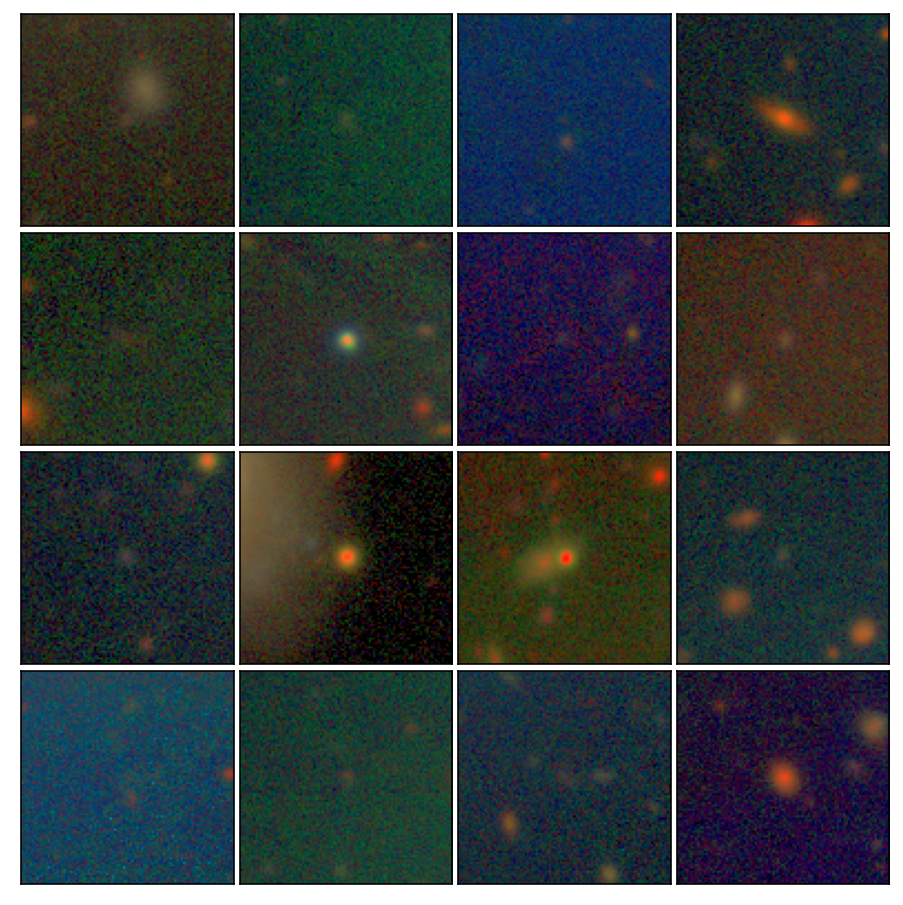

In [61]:
locs = np.where((disc_scores < gen_scores) & (disc_scores > 3))[0]
idxs_sub = [idxs[loc] for loc in locs]
print(len(idxs_sub))
np.random.seed(8)
idxs_sub = np.random.choice(idxs_sub, nplot, replace=False)
saveto = f'{plot_dir}/score_effect_3sigdisc_gengreater.png'
plotter.plot_ims(idxs_sub, nrows, ncols, tight=True, hspace=0.032, wspace=-0.08, saveto=saveto)

3285


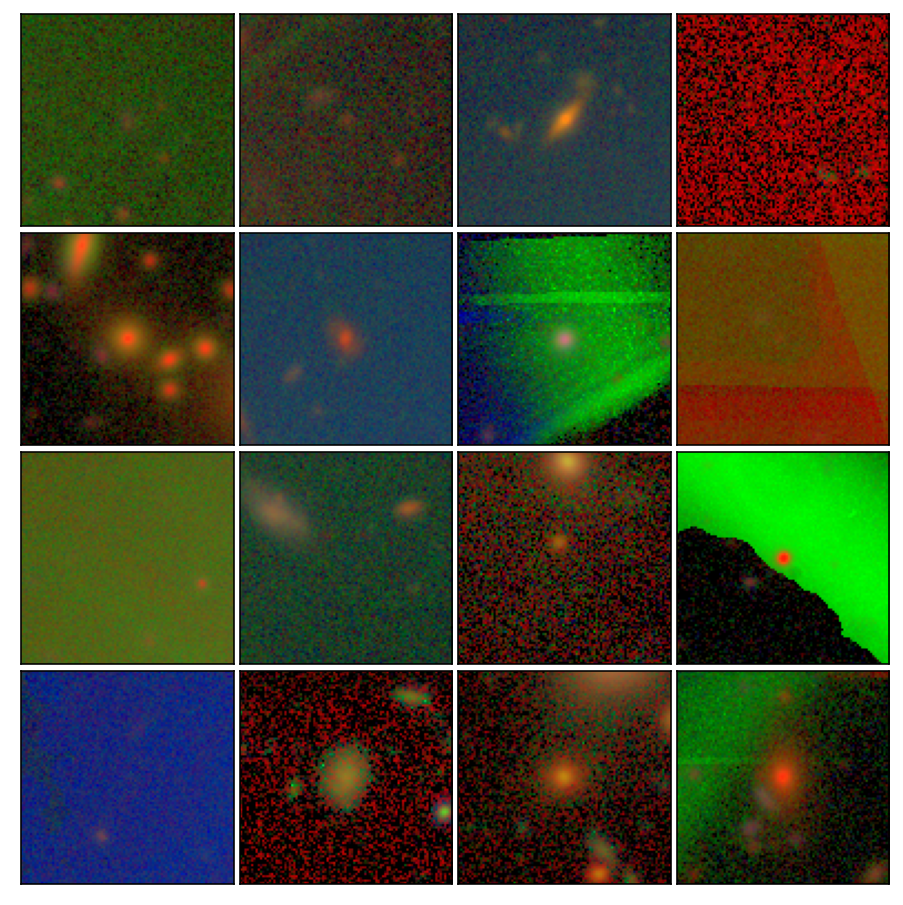

In [62]:
locs = np.where((disc_scores > gen_scores) & (gen_scores > 3))[0]
idxs_sub = [idxs[loc] for loc in locs]
print(len(idxs_sub))
np.random.seed(8)
idxs_sub = np.random.choice(idxs_sub, nplot, replace=False)
saveto = f'{plot_dir}/score_effect_3siggen_discgreater.png'
plotter.plot_ims(idxs_sub, nrows, ncols, tight=True, hspace=0.032, wspace=-0.08, saveto=saveto)

8243


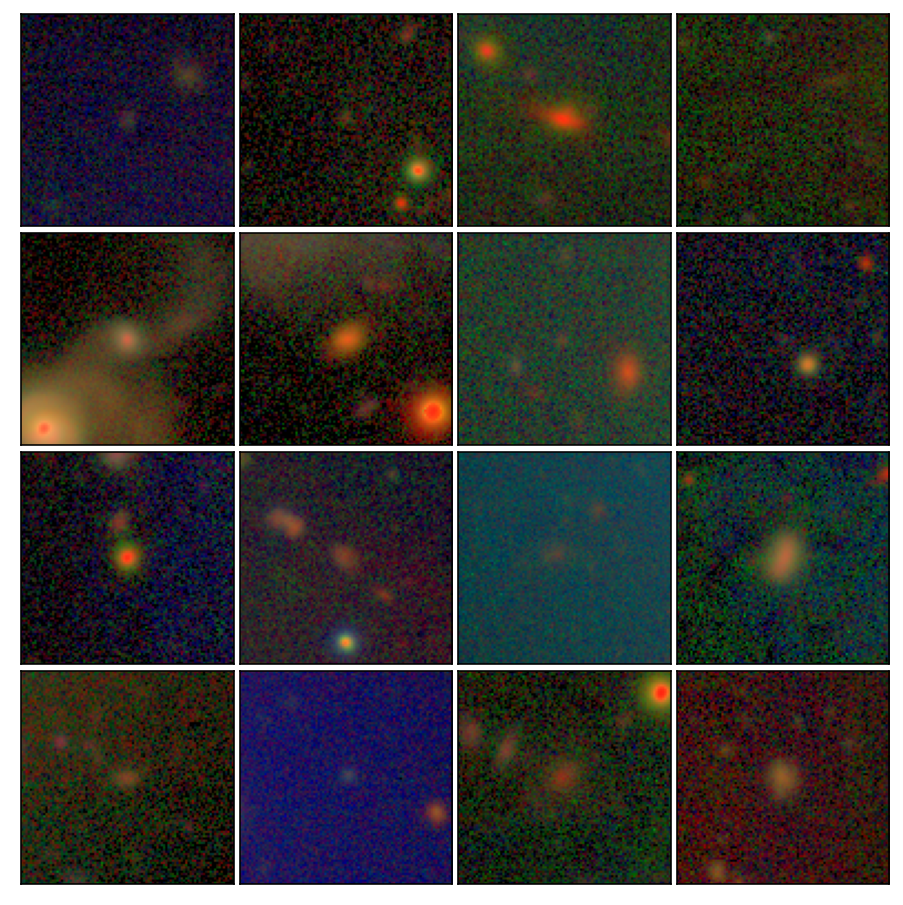

In [63]:
locs = np.where((disc_scores < gen_scores) & (gen_scores > 3))[0]
idxs_sub = [idxs[loc] for loc in locs]
print(len(idxs_sub))
np.random.seed(8)
idxs_sub = np.random.choice(idxs_sub, nplot, replace=False)
saveto = f'{plot_dir}/score_effect_3siggen_gengreater.png'
plotter.plot_ims(idxs_sub, nrows, ncols, tight=True, hspace=0.032, wspace=-0.08, saveto=saveto)

## Score distribution

-4.68004 25.4914 -1.0076863e-06 1.0
-2.290271 35.175587 1.5472738e-08 0.9999999


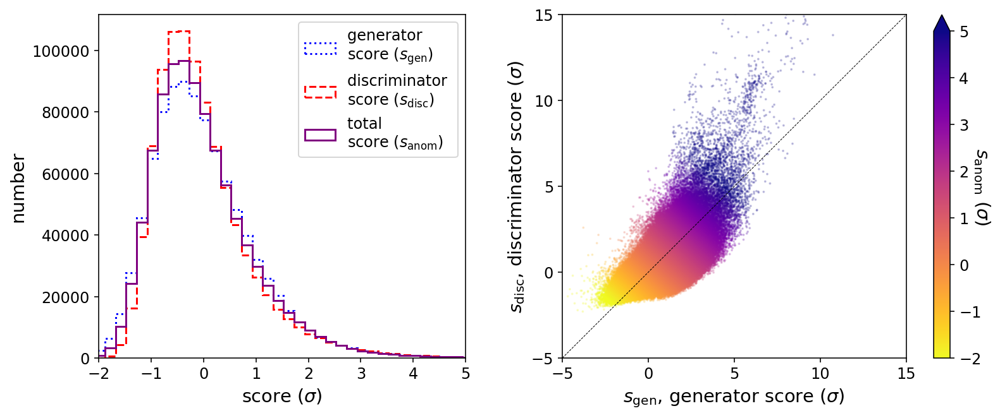

In [64]:
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')
gen_scores = res['gen_scores_sigma'][:]
disc_scores = res['disc_scores_sigma'][:]
scores = res['anomaly_scores_sigma'][:]

saveto = f'{plot_dir}/score_distribution.png'
plotter.plot_anomaly_dist(gen_scores, disc_scores, scores, saveto=saveto)

In [65]:
print(min(gen_scores), max(gen_scores))
print(min(disc_scores), max(disc_scores))
print(min(scores), max(scores))

-4.68004 25.4914
-2.290271 35.175587
-3.3166945 32.37835


### 100k

In [15]:
embed_dir = f"{base_dir}/results/embeddings"

tag_u = 'gri_100k_lambda0.3'
umap_tag = '_nn5md0.1'

results_fn_u = f'{base_dir}/results/results_{tag_u}.h5'
res_u = h5py.File(results_fn_u, 'r')
scores_u = res_u['disc_scores_sigma']

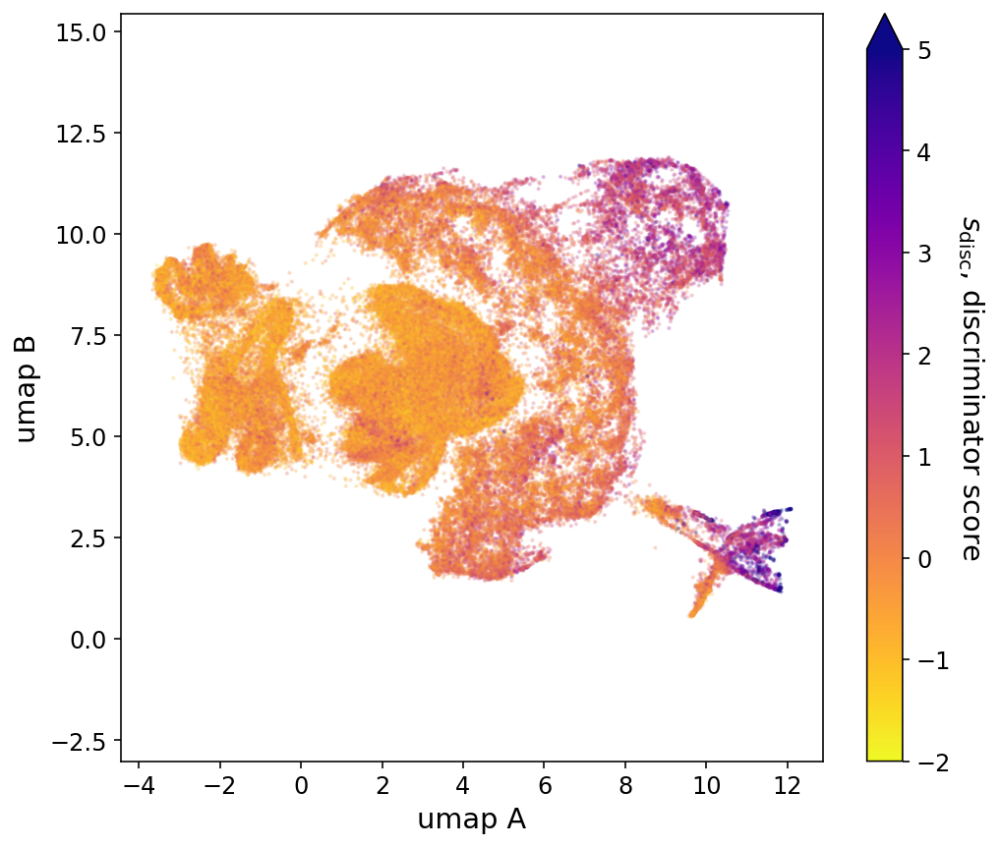

In [31]:
embedding = np.load(f"{embed_dir}/embedding_umap_reals_{tag_u}{umap_tag}.npy")
saveto = f'{plot_dir}/umap_{tag_u}_reals.png'
plotter.plot_umap(embedding, colorby=scores_u, vmin=-2, vmax=5, saveto=saveto)

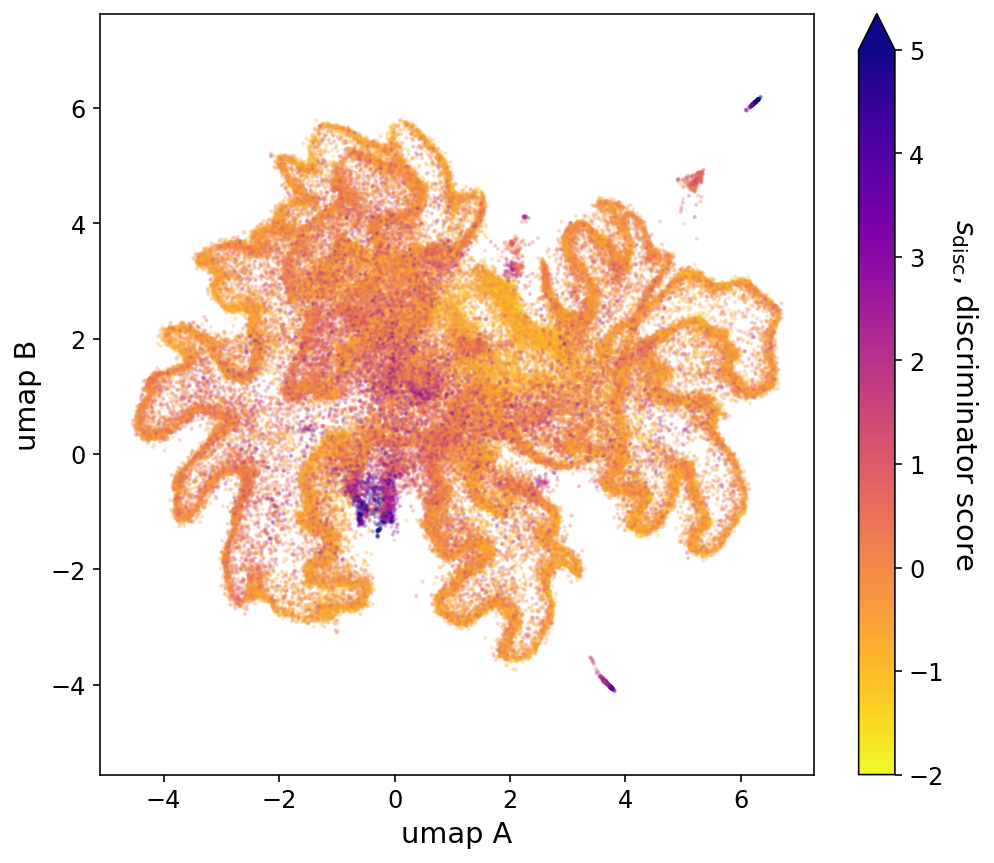

In [30]:
embedding = np.load(f"{embed_dir}/embedding_umap_residuals_{tag_u}{umap_tag}.npy")
saveto = f'{plot_dir}/umap_{tag_u}_resids.png'
plotter.plot_umap(embedding, colorby=scores_u, vmin=-2, vmax=5, saveto=saveto)

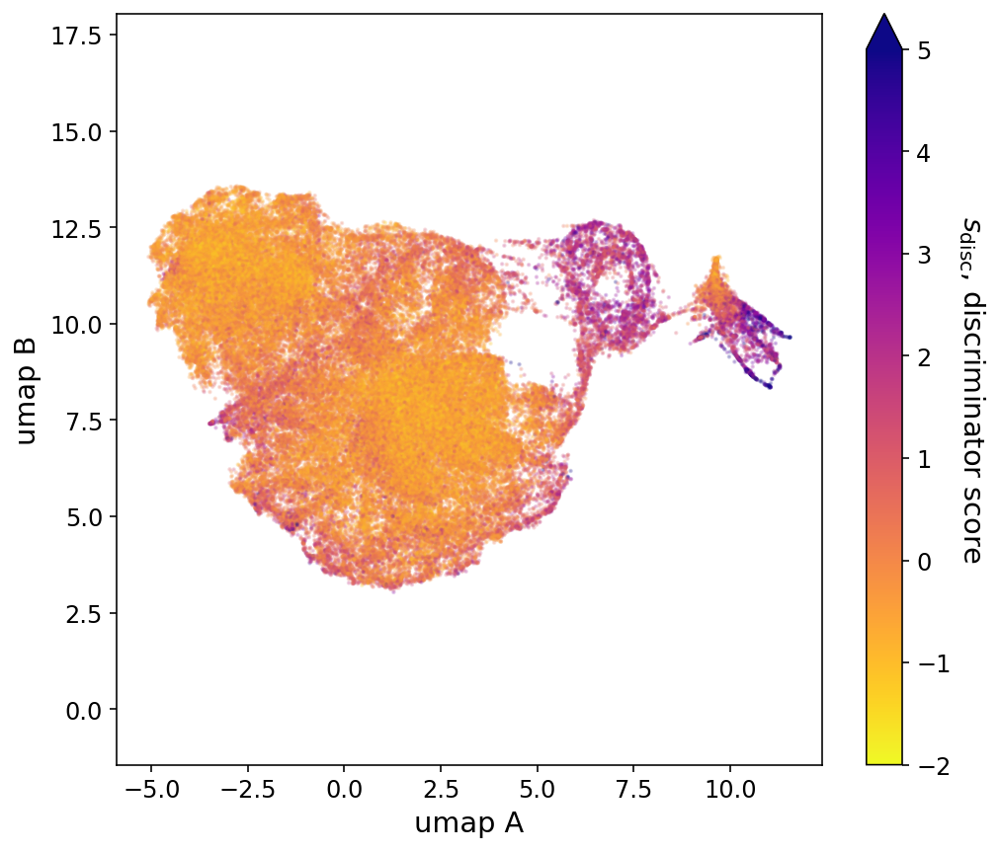

In [16]:
auto_tag = '_model15000_latent64'
embedding = np.load(f"{embed_dir}/embedding_umap_auto_{tag_u}{auto_tag}_reals{umap_tag}.npy", allow_pickle=True)
saveto = f'{plot_dir}/umap_{tag_u}_reals_auto.png'
plotter.plot_umap(embedding, colorby=scores_u, vmin=-2, vmax=5,  saveto=saveto)

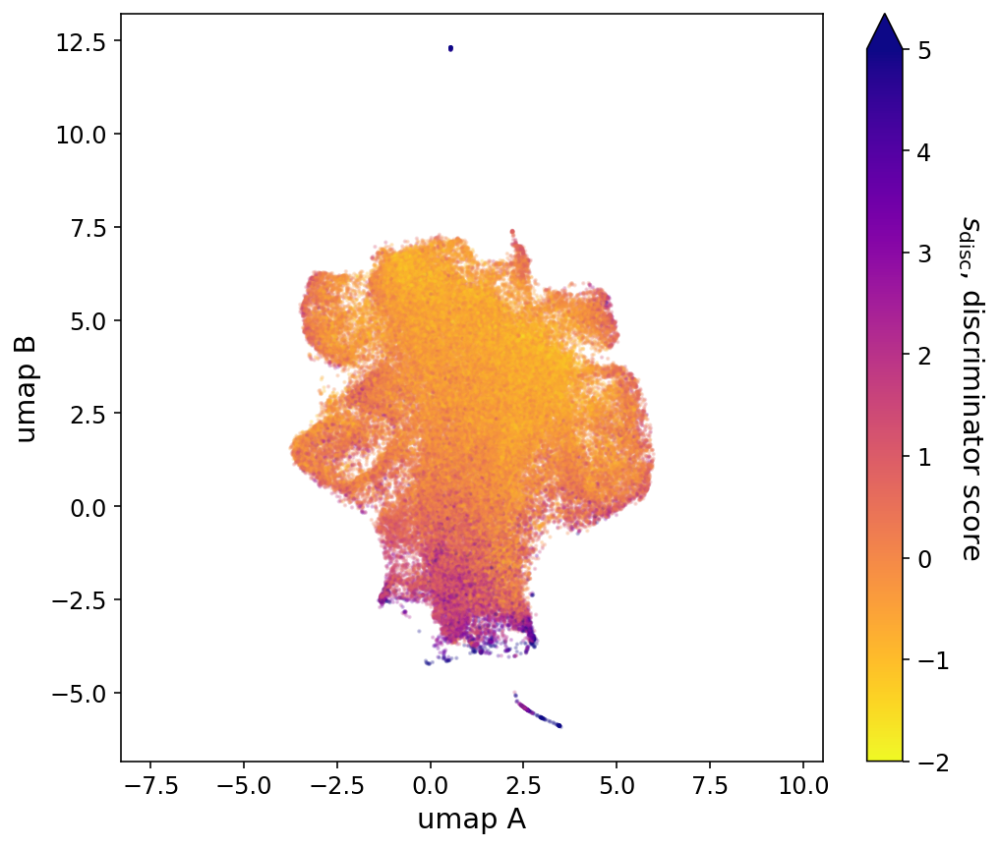

In [19]:
auto_tag = '_model50000_latent64'
embedding = np.load(f"{embed_dir}/embedding_umap_auto_{tag_u}{auto_tag}_residuals{umap_tag}.npy", allow_pickle=True)
saveto = f'{plot_dir}/umap_{tag_u}_resids_auto.png'
plotter.plot_umap(embedding, colorby=scores_u, vmin=-2, vmax=5,  saveto=saveto)

### 3sigdisc

In [105]:
embed_dir = f"{base_dir}/results/embeddings"

#tag_u = 'gri_10k_lambda0.3'
tag_u = 'gri_lambda0.3_3sigdisc'
umap_tag = '_nn5md0.1'
#auto_tag = '_model29500_latent16'
auto_tag = '_model15000_latent64'

results_fn_u = f'{base_dir}/results/results_{tag_u}.h5'
res_u = h5py.File(results_fn_u, 'r')
scores_u = res_u['disc_scores_sigma']

In [8]:
import matplotlib.colors as colors
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n)))
    return new_cmap

cmap = plt.get_cmap('Purples')
cmap_purp = truncate_colormap(cmap, 0.25, 1.0)

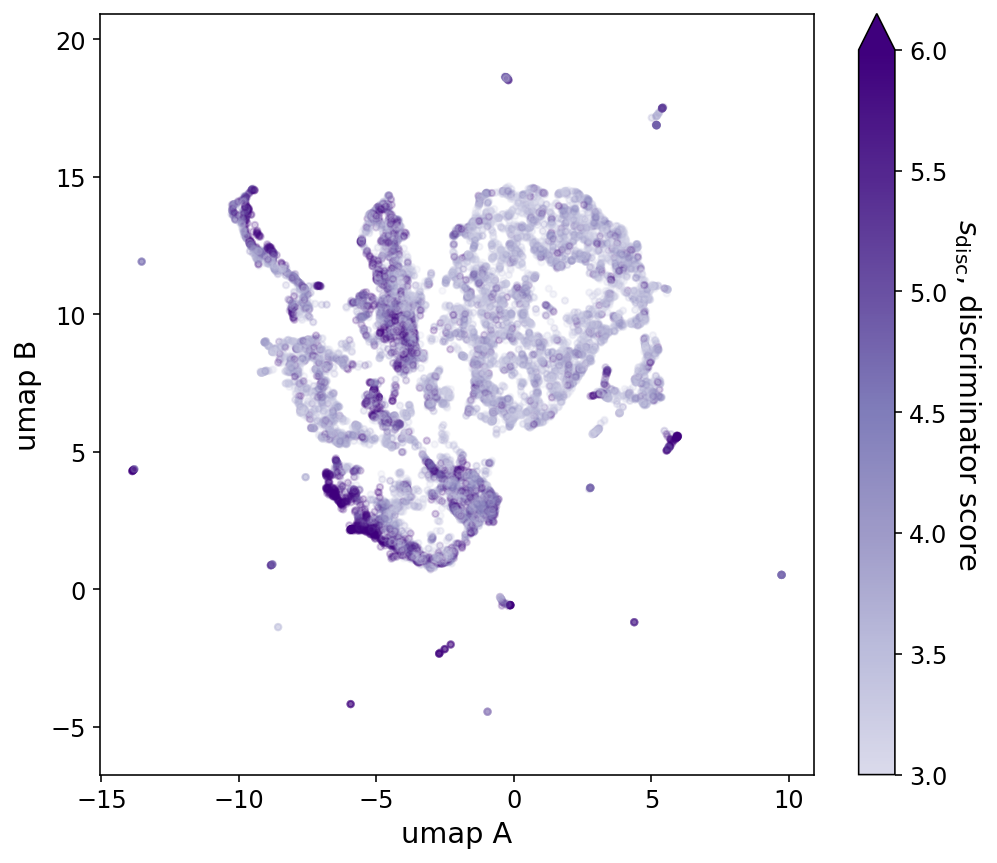

In [108]:
embedding_3sigdisc = np.load(f"{embed_dir}/embedding_umap_reals_{tag_u}{umap_tag}.npy")
#saveto = f'{plot_dir}/umap_{tag_u}_residuals.png'
saveto = None
plotter.plot_umap(embedding_3sigdisc, colorby=scores_u, cmap=cmap_purp, vmin=3, vmax=6, s=40, saveto=saveto)

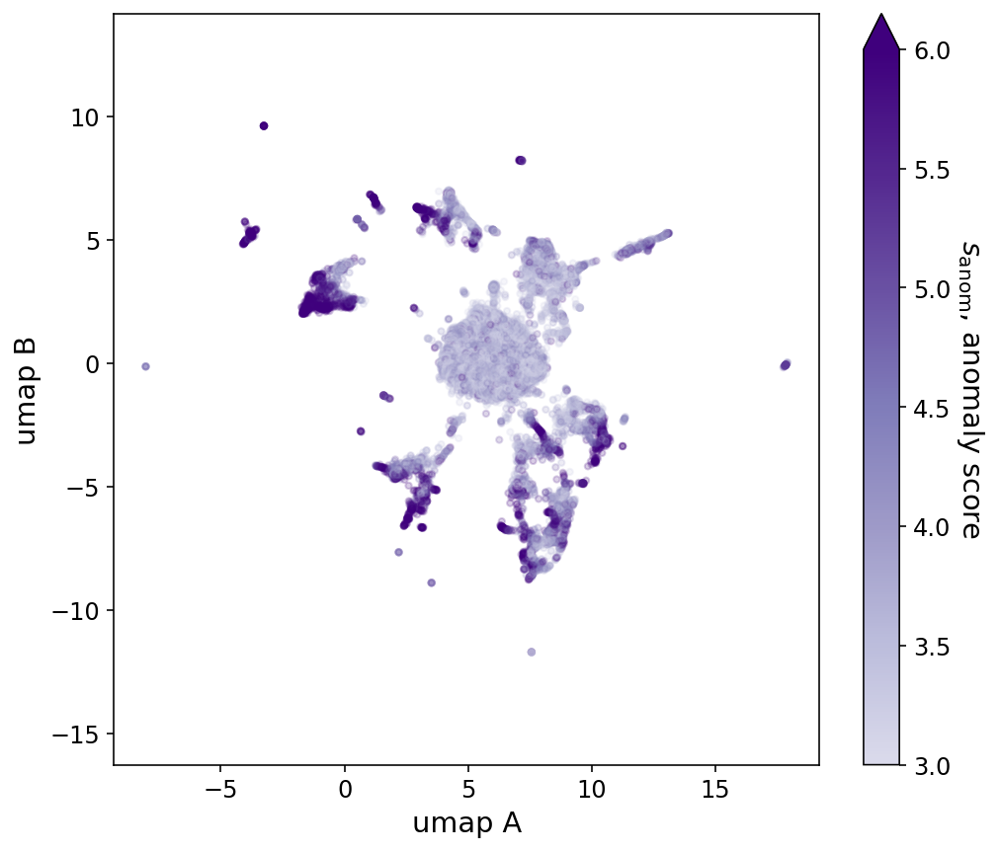

In [28]:
embedding_3sigdisc = np.load(f"{embed_dir}/embedding_umap_residuals_{tag_u}{umap_tag}.npy")
#saveto = f'{plot_dir}/umap_{tag_u}_residuals.png'
saveto = None
plotter.plot_umap(embedding_3sigdisc, colorby=scores_u, cmap=cmap_purp, vmin=3, vmax=6, s=40, saveto=saveto)

/scratch/ksf293/anomalies/results/embeddings/embedding_umap_auto_gri_lambda0.3_3sigdisc_model15000_latent64_reals_nn5md0.1.npy


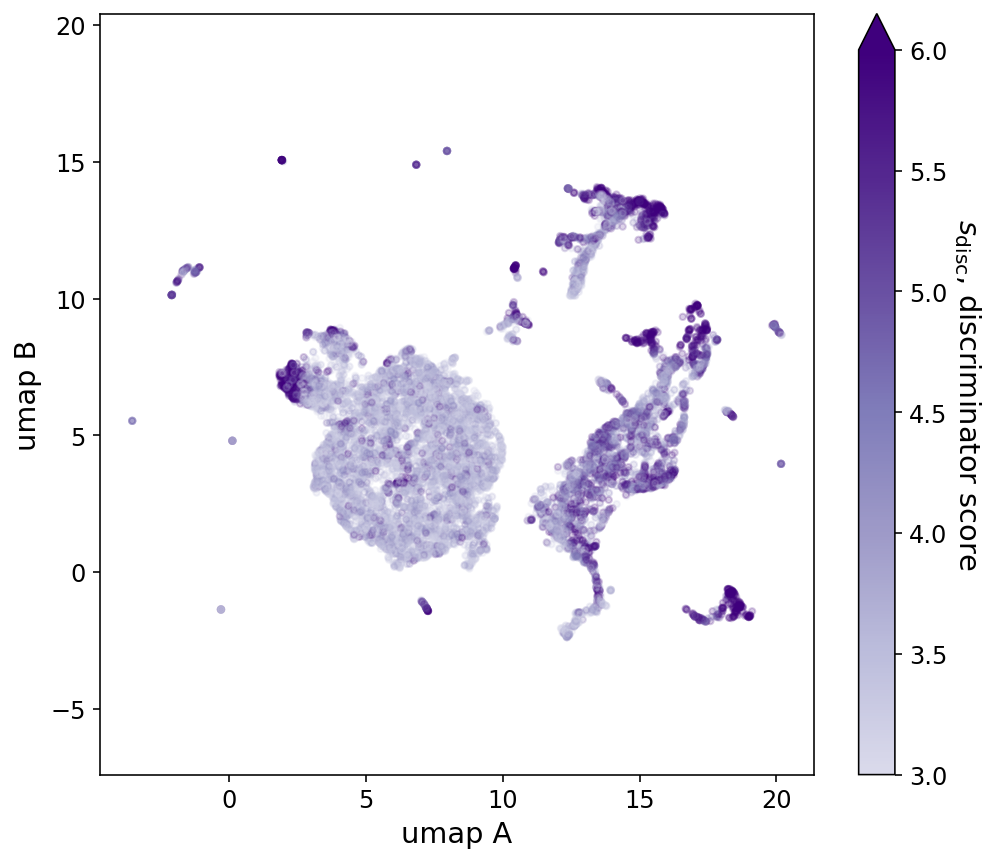

In [112]:
embed_fn = f"{embed_dir}/embedding_umap_auto_{tag_u}{auto_tag}_reals{umap_tag}.npy"
print(embed_fn)
embedding_3sigdisc = np.load(embed_fn, allow_pickle=True)
saveto = None
#saveto = f'{plot_dir}/umap_{taga}_reals_auto.png'
plotter.plot_umap(embedding_3sigdisc, colorby=scores_u, cmap=cmap_purp, vmin=3, vmax=6, s=40, saveto=saveto)

/scratch/ksf293/anomalies/results/embeddings/embedding_umap_auto_gri_lambda0.3_3sigdisc_model15000_latent64_residuals_nn5md0.1.npy


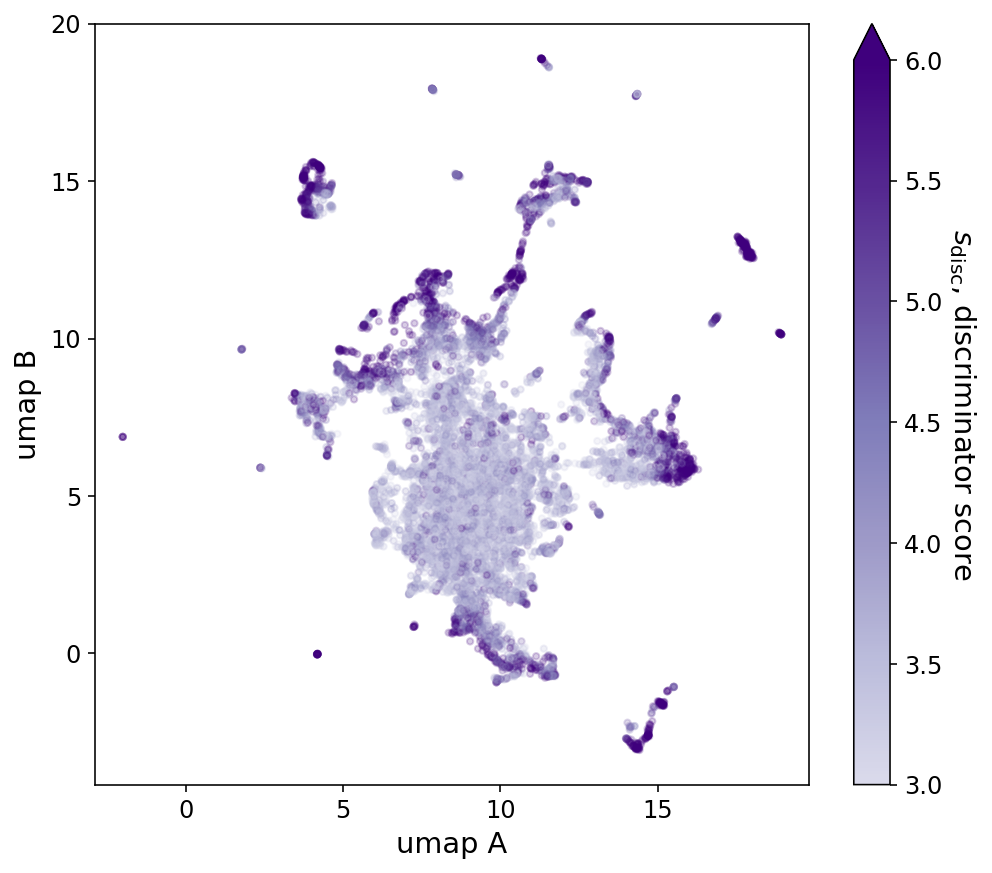

In [114]:
embed_fn = f"{embed_dir}/embedding_umap_auto_{tag_u}{auto_tag}_residuals{umap_tag}.npy"
print(embed_fn)
embedding_3sigdisc = np.load(embed_fn, allow_pickle=True)
saveto = None
#saveto = f'{plot_dir}/umap_{taga}_reals_auto.png'
plotter.plot_umap(embedding_3sigdisc, colorby=scores_u, cmap=cmap_purp, vmin=3, vmax=6, s=40, saveto=saveto)

## box umap for residuals (NOT autoencoded)

In [22]:
n_ims = 5

In [21]:
box_red = [-1,-0.5,2,2.5]
bcolor_red = 'red'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc, box_red, n_ims, seed=42) #39
saveto = f'{plot_dir}/recons_box_{bcolor_red}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_red, saveto=saveto)

NameError: name 'embedding_3sigdisc' is not defined

162


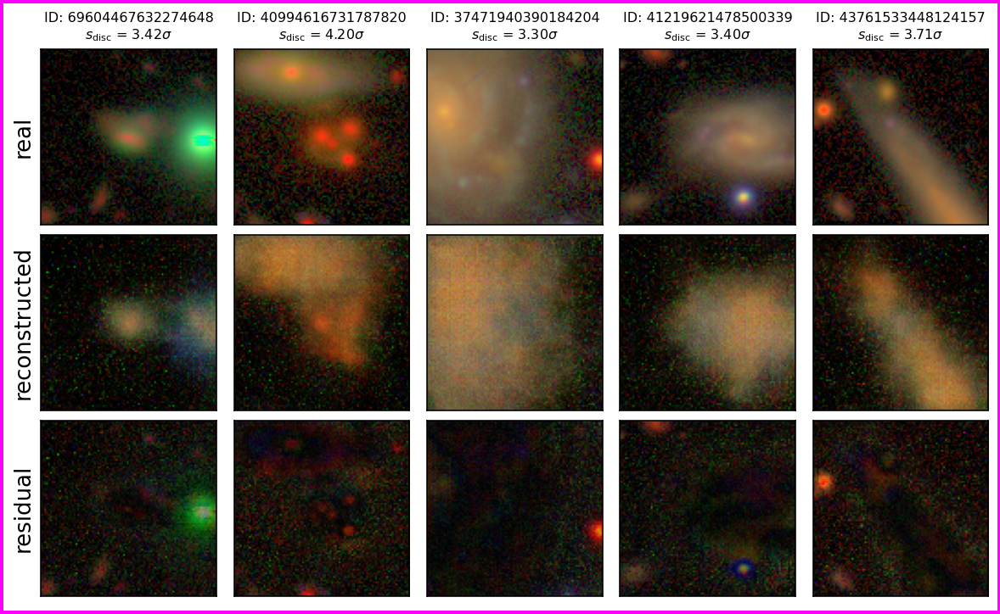

In [89]:
box_center = [5.5,6,0,0.5]
bcolor_center = 'magenta'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc, box_center, n_ims, seed=43) #39, 40, 42, 41
saveto = f'{plot_dir}/recons_box_{bcolor_center}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_center, saveto=saveto)

55


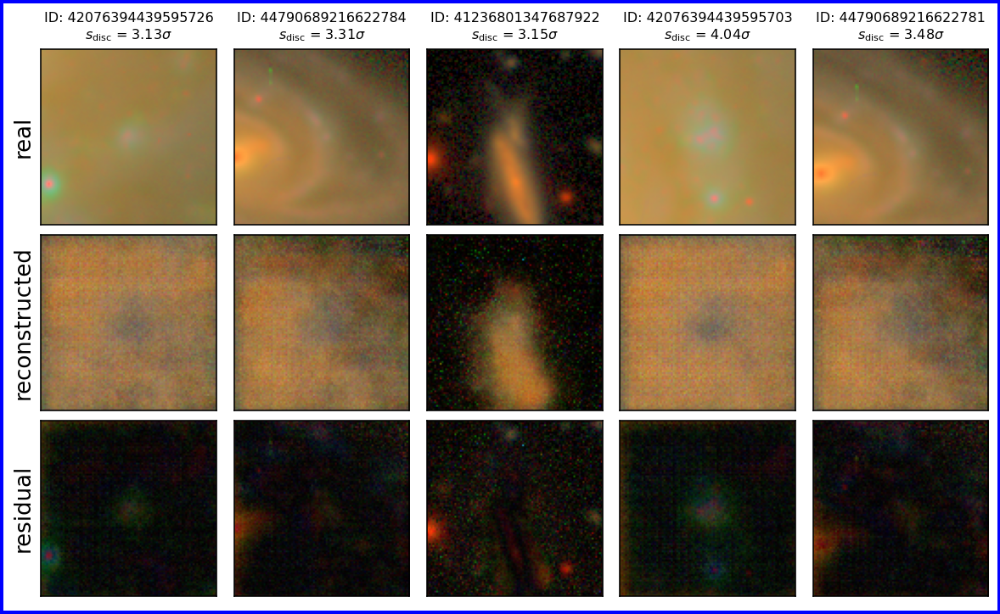

In [68]:
box_right = [8.5,9,1.5,2]
bcolor_right = 'blue'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc, box_right, n_ims, seed=44) #39, 44
saveto = f'{plot_dir}/recons_box_{bcolor_right}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_right, saveto=saveto)

37


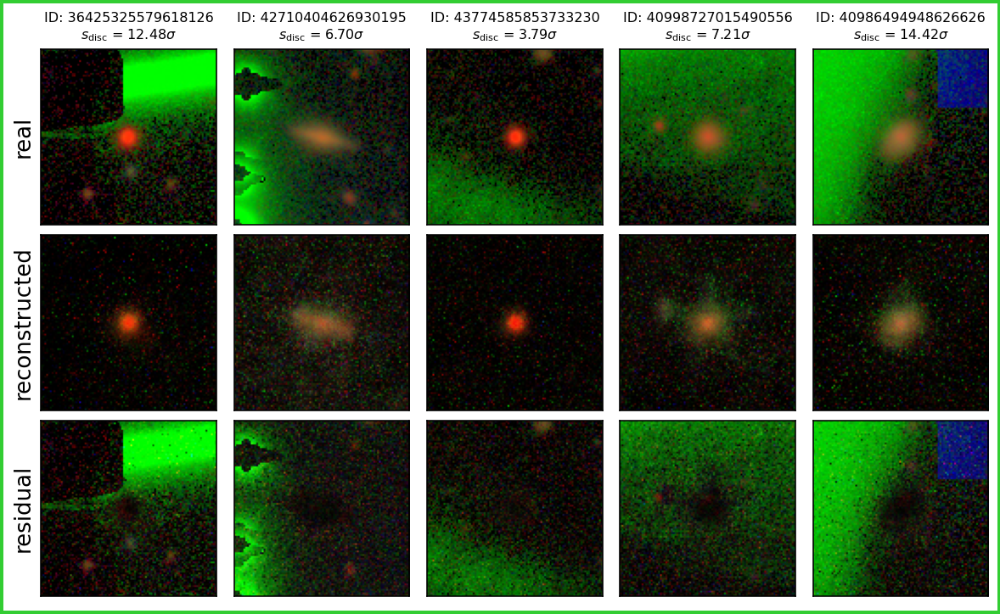

In [77]:
box_green = [3,3.5,-6,-5.5]
bcolor_green = 'limegreen'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc, box_green, n_ims, seed=45) 
saveto = f'{plot_dir}/recons_box_{bcolor_green}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_green, saveto=saveto)

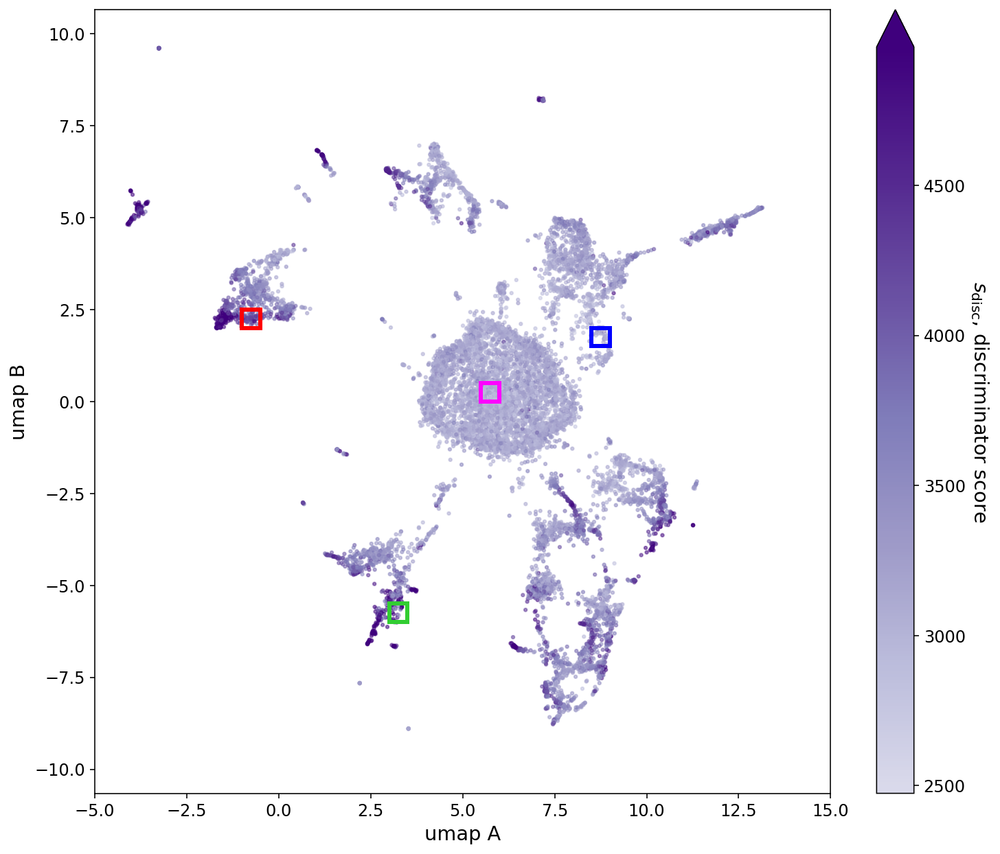

In [103]:
#boxes = [box_stripes, box_multi, box_many, box_blue]
#bcolors = [bcolor_stripes, bcolor_multi, bcolor_many, bcolor_blue]
boxes = [box_center, box_right, box_red, box_green]
bcolors = [bcolor_center, bcolor_right, bcolor_red, bcolor_green]
saveto = f'{plot_dir}/umap_3sigdisc_resids_boxes.png'
plotter.plot_umap(embedding_3sigdisc, boxes=boxes, box_colors=bcolors, cmap=cmap_purp, figsize=(12,10.5), 
          alpha=0.5, s=20, xlim=[-5,15], ylim=[-10,10], saveto=saveto)

## box umap - autoencoded residual

In [6]:
embed_dir = f"{base_dir}/results/embeddings"

tag_u = 'gri_lambda0.3_3sigdisc'
umap_tag = '_nn5md0.1'
auto_tag = '_model15000_latent64'

results_fn_u = f'{base_dir}/results/results_{tag_u}.h5'
res_u = h5py.File(results_fn_u, 'r')
scores_u = res_u['disc_scores_sigma']

/scratch/ksf293/anomalies/results/embeddings/embedding_umap_auto_gri_lambda0.3_3sigdisc_model15000_latent64_residuals_nn5md0.1.npy


<AxesSubplot:xlabel='umap A', ylabel='umap B'>

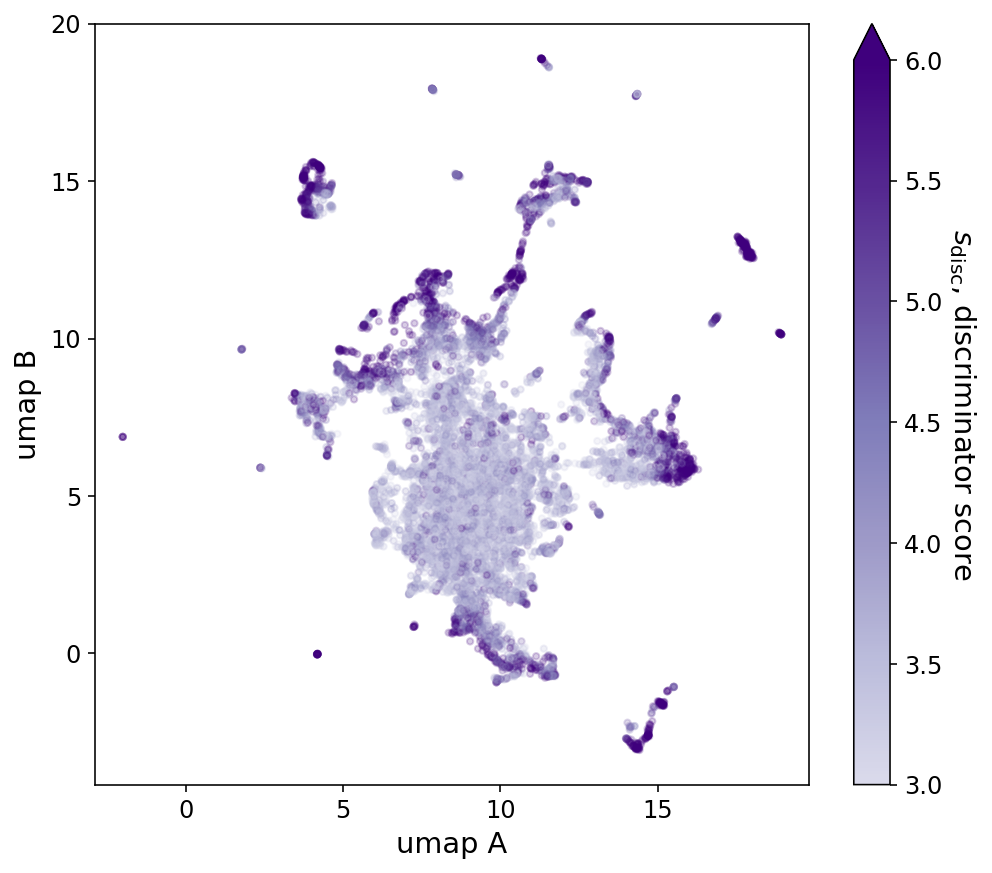

In [12]:
embed_fn = f"{embed_dir}/embedding_umap_auto_{tag_u}{auto_tag}_residuals{umap_tag}.npy"
print(embed_fn)
embedding_3sigdisc_auto_resid = np.load(embed_fn, allow_pickle=True)
saveto = None
plotter.plot_umap(embedding_3sigdisc_auto_resid, colorby=scores_u, cmap=cmap_purp, vmin=3, vmax=6, s=40, saveto=saveto)

In [13]:
n_ims = 5

28


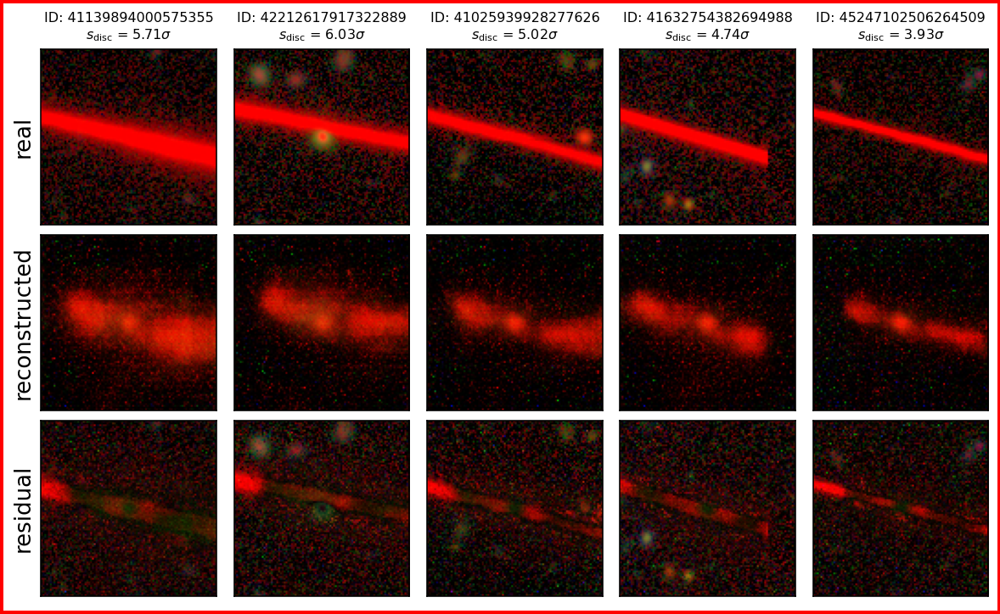

In [14]:
box_red = [16.5,17,10.25,10.75]
bcolor_red = 'red'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc_auto_resid, box_red, n_ims, seed=42) #39
saveto = f'{plot_dir}/recons_box_{bcolor_red}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_red, saveto=saveto)

78


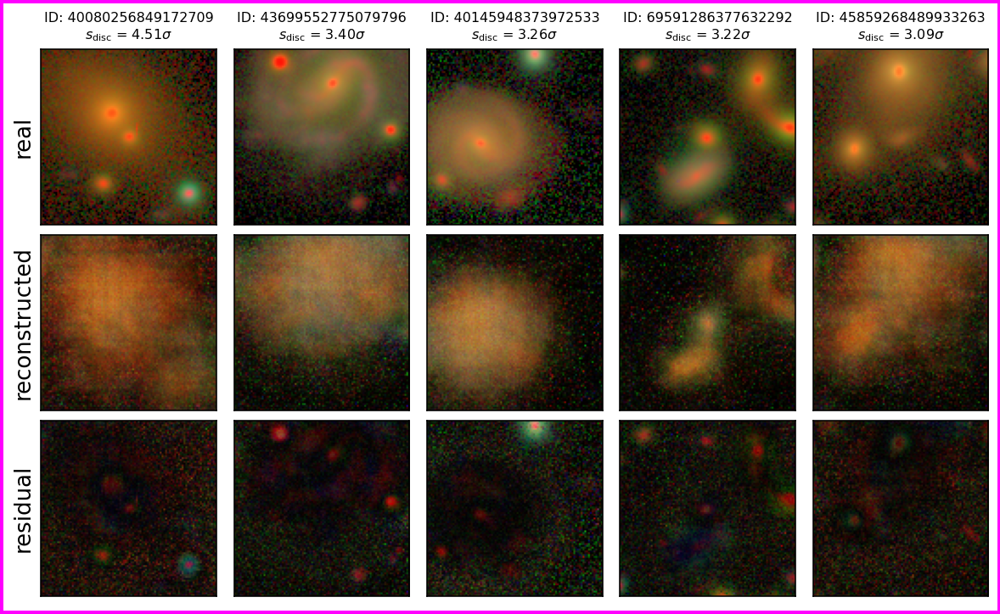

In [15]:
#box_center = [9,9.5,4.5,5]
box_center = [10,10.5,4.5,5]
bcolor_center = 'magenta'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc_auto_resid, box_center, n_ims, seed=42) #42
saveto = f'{plot_dir}/recons_box_{bcolor_center}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_center, saveto=saveto)

48


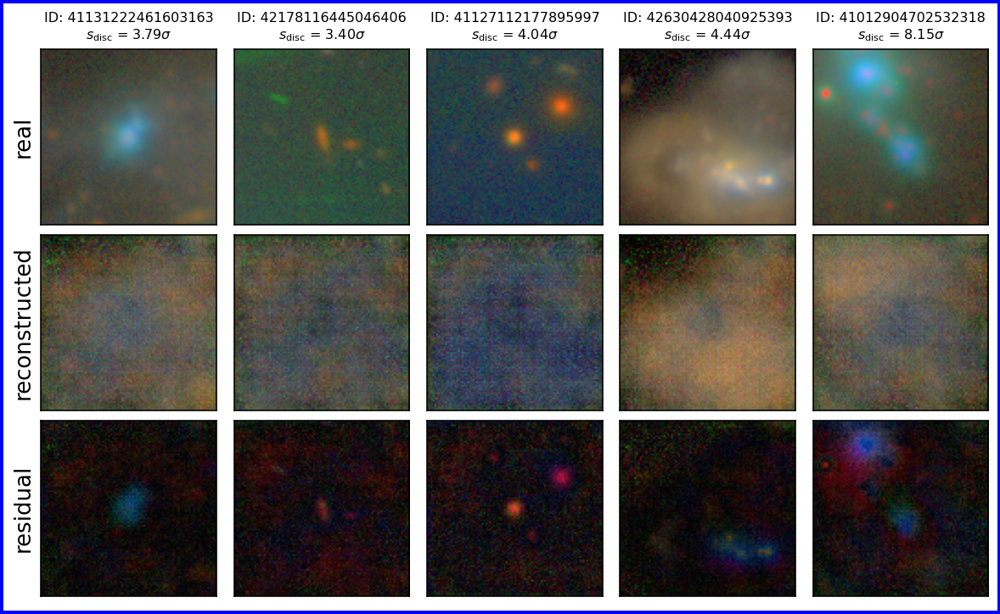

In [16]:
box_right = [4.25,4.75,6.75,7.25]
#box_right = [9.5,10,2,2.5]
bcolor_right = 'blue'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc_auto_resid, box_right, n_ims, seed=42) # 42
saveto = f'{plot_dir}/recons_box_{bcolor_right}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_right, saveto=saveto)

46


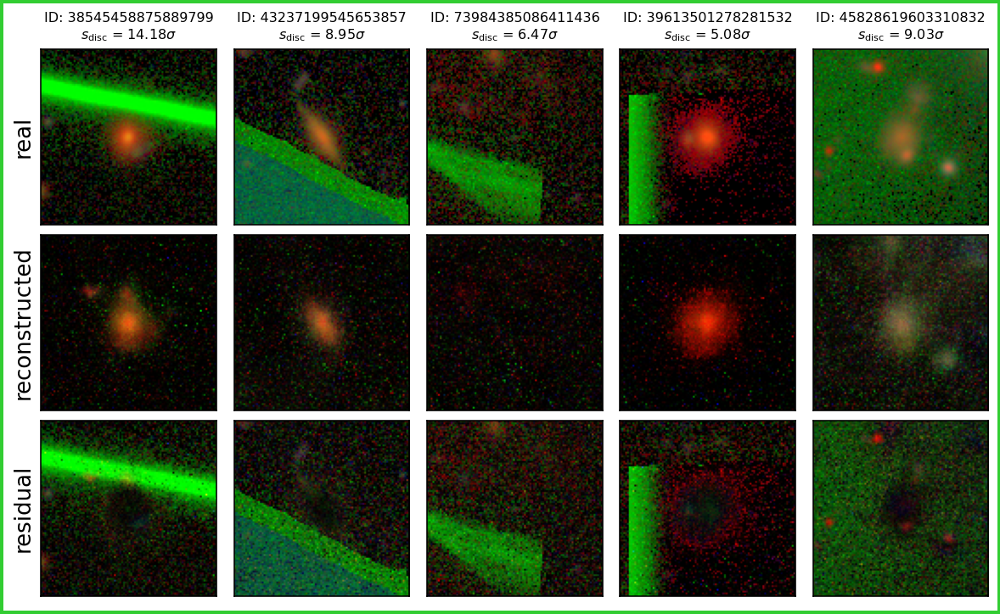

In [17]:
box_green = [7.5,8,11.5,12]
bcolor_green = 'limegreen'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc_auto_resid, box_green, n_ims, seed=41) 
saveto = f'{plot_dir}/recons_box_{bcolor_green}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_green, saveto=saveto)

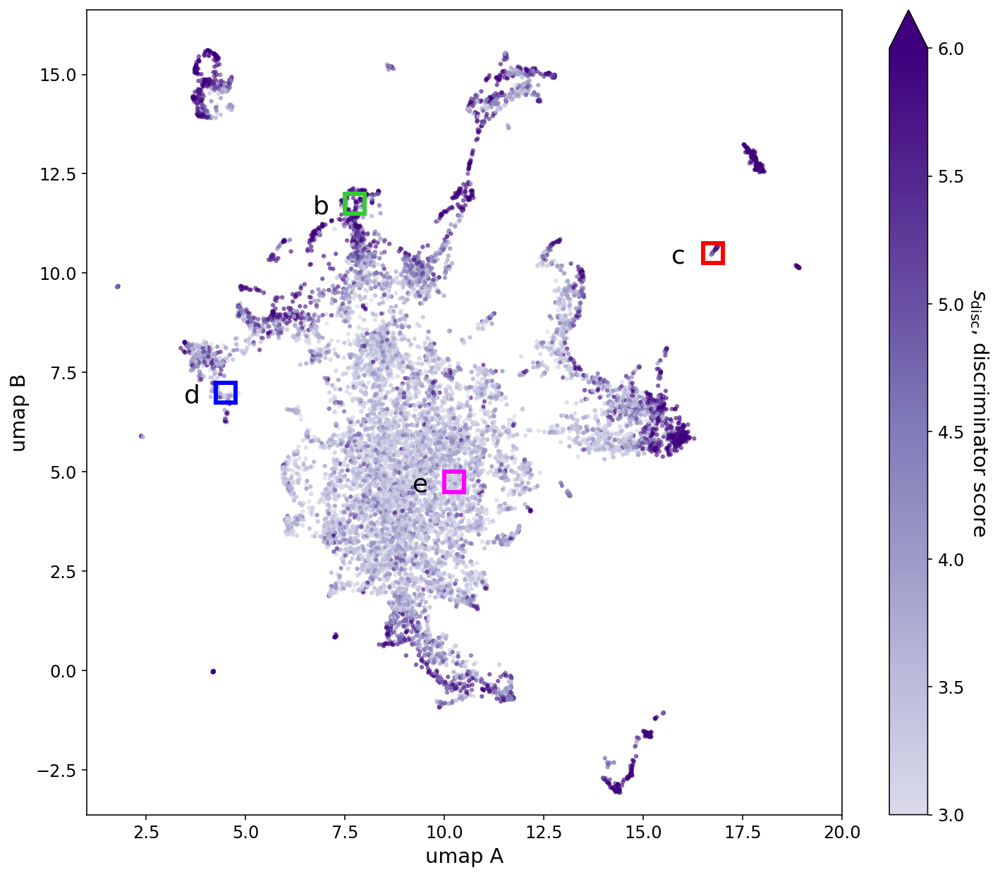

In [25]:
#boxes = [box_stripes, box_multi, box_many, box_blue]
#bcolors = [bcolor_stripes, bcolor_multi, bcolor_many, bcolor_blue]
boxes = [box_center, box_right, box_red, box_green]
bcolors = [bcolor_center, bcolor_right, bcolor_red, bcolor_green]
blabels = ['e', 'd', 'c', 'b']
saveto = f'{plot_dir}/umap_3sigdisc_auto_resids_boxes.png'
ax = plotter.plot_umap(embedding_3sigdisc_auto_resid, boxes=boxes, box_colors=bcolors, box_labels=blabels,
                       cmap=cmap_purp, figsize=(12,10.5), alpha=0.5, s=20, xlim=[1,20], ylim=[-3,16], 
                       saveto=saveto, vmin=3, vmax=6)

# HSC catalog correlation

Loading data
Loading catalog
Getting blend & extend
Plotting


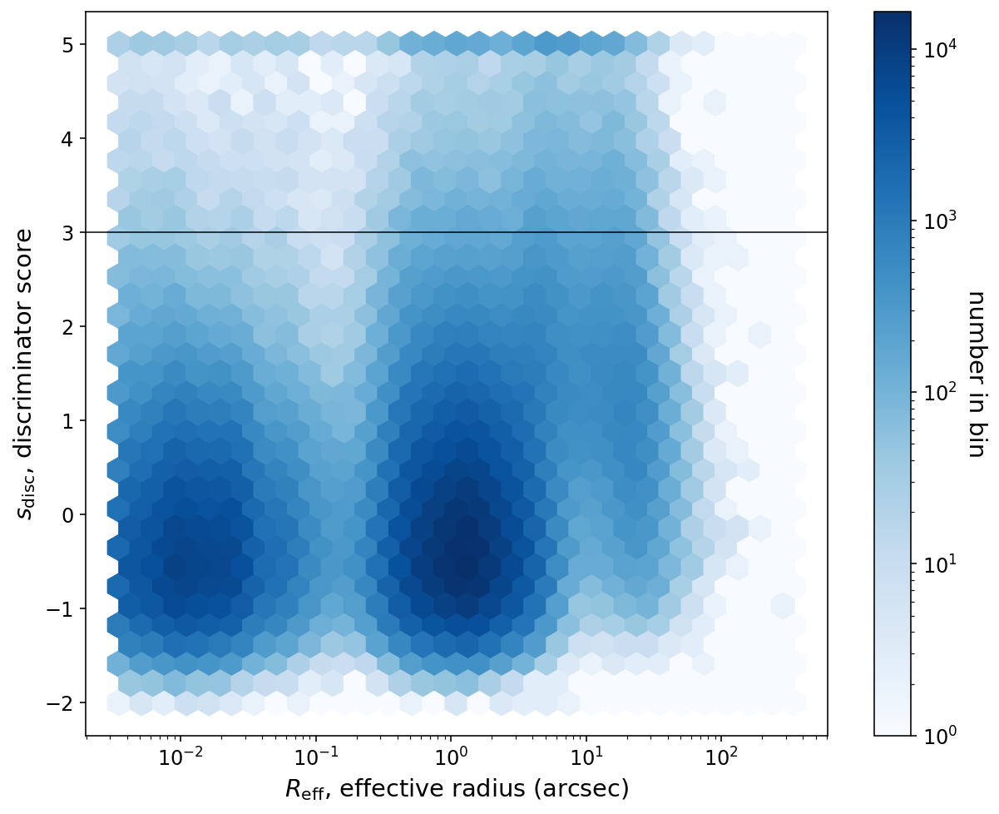

In [37]:
tag = 'gri_lambda0.3'

savetag = ''
saveto = f'{plot_dir}/sdisc-reff_{tag}.png'

results_dir = f'{base_dir}/results'
results_fn = f'{results_dir}/results_{tag}.h5'
cat_fn = f'{base_dir}/data/hsc_catalogs/pdr2_wide_icmod_20.0-20.5_clean_more.csv'

plotter.plot_cross_hexbin(results_fn, cat_fn, 'extendedness', saveto=saveto)

Loading data
Loading catalog
Getting blend & extend
Plotting


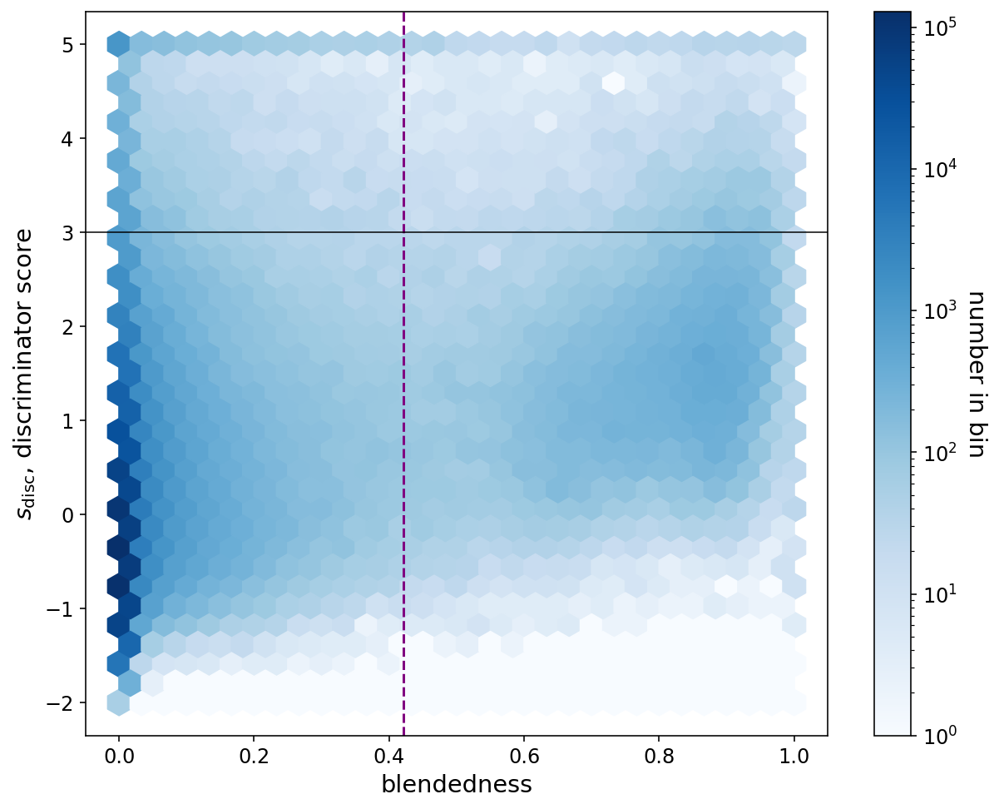

In [38]:
tag = 'gri_lambda0.3'
saveto = f'{plot_dir}/sdisc-blendedness_{tag}.png'

results_dir = f'{base_dir}/results'
results_fn = f'{results_dir}/results_{tag}.h5'
cat_fn = f'{base_dir}/data/hsc_catalogs/pdr2_wide_icmod_20.0-20.5_clean_more.csv'

plotter.plot_cross_hexbin(results_fn, cat_fn, 'blendedness', saveto=saveto)

In [24]:
def plot_extendedness_magnitude(results_fn, cat_fn, cmap='plasma', saveto=None):
    print("Loading data")
    res = h5py.File(results_fn, 'r')
    scores = res['disc_scores_sigma']
    idxs = [int(idx) for idx in res['idxs'][:]]

    print("Loading catalog")
    x_col_name = {'extendedness': 'i_cmodel_ellipse_radius',
                  'magnitude': 'r_cmodel_mag'}
    cols = list(x_col_name.values())
    cols.append('idx')
    cat = pd.read_csv(cat_fn, usecols=cols, squeeze=True)

    print("Getting blend & mag")
    ext_vals = [cat[x_col_name['extendedness']].iloc[idx] for idx in idxs]
    mag_vals = [cat[x_col_name['magnitude']].iloc[idx] for idx in idxs]
    scores = [s if s<=5 else 5 for s in scores] #pile extreme scores into edge bins
    scores = [s if s>=-2 else -2 for s in scores]

    print("Plotting")
    plt.figure(figsize=(10,8))
    plt.scatter(ext_vals, mag_vals, marker='.', c=scores, cmap=cmap, s=16, alpha=0.8)

    plt.xscale('log')

    plt.xlabel(r'$R_\mathrm{eff}$, effective radius (arcsec)')
    plt.ylabel(r'r-band magnitude')
    plt.ylim(18, 27)
    cbar = plt.colorbar()
    cbar.set_label(r'$s_\mathrm{disc}$, discriminator score', rotation=270, labelpad=18)

    res.close()

    if saveto:
        plt.savefig(saveto, bbox_inches='tight', pad_inches=0.1)

Loading data
Loading catalog
Getting blend & mag
Plotting


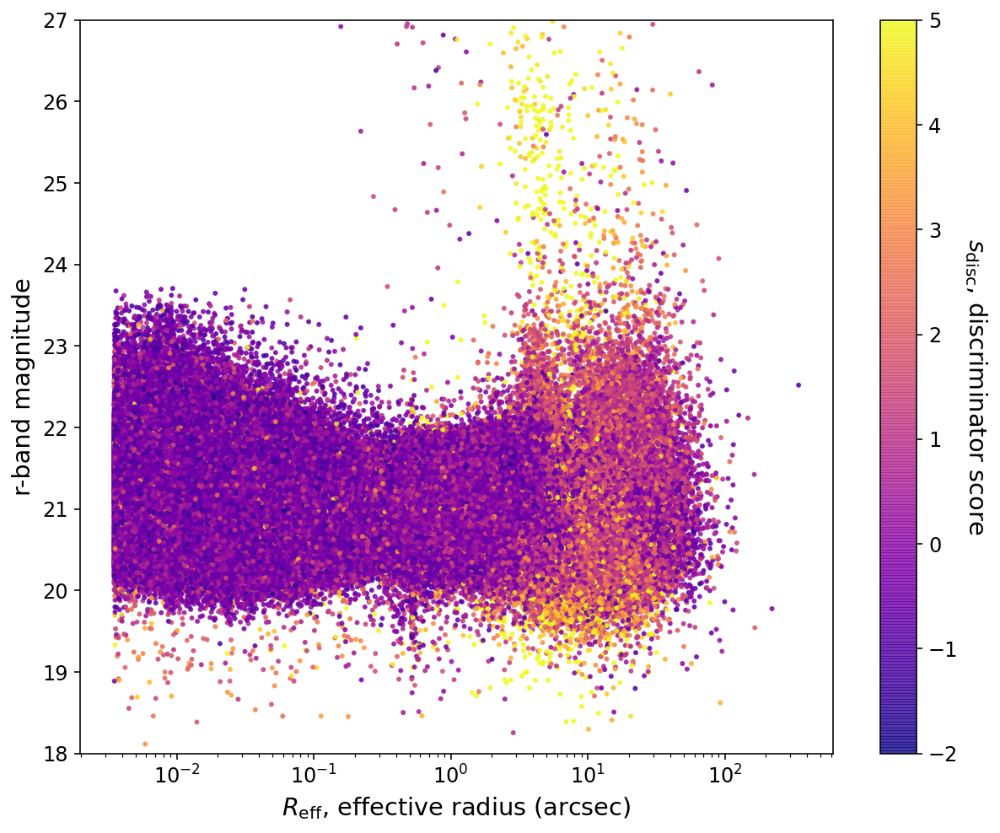

In [25]:
tag = 'gri_lambda0.3'
saveto = f'{plot_dir}/extendedness-magnitude_{tag}.png'

results_dir = f'{base_dir}/results'
results_fn = f'{results_dir}/results_{tag}.h5'
cat_fn = f'{base_dir}/data/hsc_catalogs/pdr2_wide_icmod_20.0-20.5_clean_more.csv'

plot_extendedness_magnitude(results_fn, cat_fn, saveto=saveto)

In [30]:
def get_threshold_values(results_fn, cat_fn, x_name):
    res = h5py.File(results_fn, 'r')
    idxs = [int(idx) for idx in res['idxs'][:]]

    print("Loading catalog")
    x_col_name = {'extendedness': 'i_cmodel_ellipse_radius',
                  'blendedness': 'i_blendedness_abs_flux'}    
    cols = [x_col_name[x_name], 'idx']
    cat = pd.read_csv(cat_fn, usecols=cols, squeeze=True)

    print("Getting blend & extend")
    x_vals = [cat[x_col_name[x_name]].iloc[idx] for idx in idxs]
    
    if x_name=='extendedness':
        thresh = 0.15
    if x_name=='blendedness':
        thresh = 10**-0.375
    n_above_thresh = len([x for x in x_vals if x>thresh])
    n_total = len(x_vals)
    print(f"results_fn = {results_fn}")
    print(f"{n_above_thresh}/{n_total} = {n_above_thresh/n_total} above threshold")
    res.close()

In [31]:
results_dir = f'{base_dir}/results'
cat_fn = f'{base_dir}/data/hsc_catalogs/pdr2_wide_icmod_20.0-20.5_clean_more.csv'

In [32]:
tag = 'gri_lambda0.3'
results_fn = f'{results_dir}/results_{tag}.h5'
get_threshold_values(results_fn, cat_fn, 'blendedness')

tag = 'gri_lambda0.3_3sigdisc'
results_fn = f'{results_dir}/results_{tag}.h5'
get_threshold_values(results_fn, cat_fn, 'blendedness')

Loading catalog
Getting blend & extend
results_fn = /scratch/ksf293/anomalies/results/results_gri_lambda0.3.h5
43845/942781 = 0.046506028441387764 above threshold
Loading catalog
Getting blend & extend
results_fn = /scratch/ksf293/anomalies/results/results_gri_lambda0.3_3sigdisc.h5
4163/11893 = 0.3500378373833347 above threshold


In [33]:
tag = 'gri_lambda0.3'
results_fn = f'{results_dir}/results_{tag}.h5'
get_threshold_values(results_fn, cat_fn, 'extendedness')

tag = 'gri_lambda0.3_3sigdisc'
results_fn = f'{results_dir}/results_{tag}.h5'
get_threshold_values(results_fn, cat_fn, 'extendedness')

Loading catalog
Getting blend & extend
results_fn = /scratch/ksf293/anomalies/results/results_gri_lambda0.3.h5
615229/942781 = 0.6525683058950064 above threshold
Loading catalog
Getting blend & extend
results_fn = /scratch/ksf293/anomalies/results/results_gri_lambda0.3_3sigdisc.h5
9040/11893 = 0.7601109896577819 above threshold


# Reconstructions by score

In [38]:
imtag = 'gri'
tag = 'gri_lambda0.3'
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')
scores = res['anomaly_scores_sigma'][:]
idxs = res['idxs'][:]
n_recons = 3

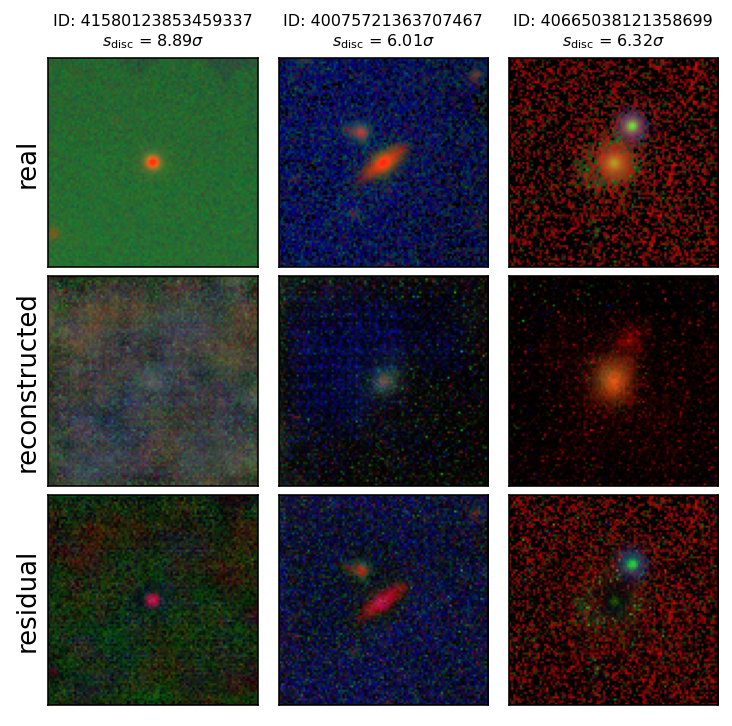

In [48]:
smin, smax = 5, 20
np.random.seed(41) #41
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plotter.plot_recons(idxs_recon, imtag, tag, saveto=f'{plot_dir}/recons_{smin}to{smax}sigdisc.png')

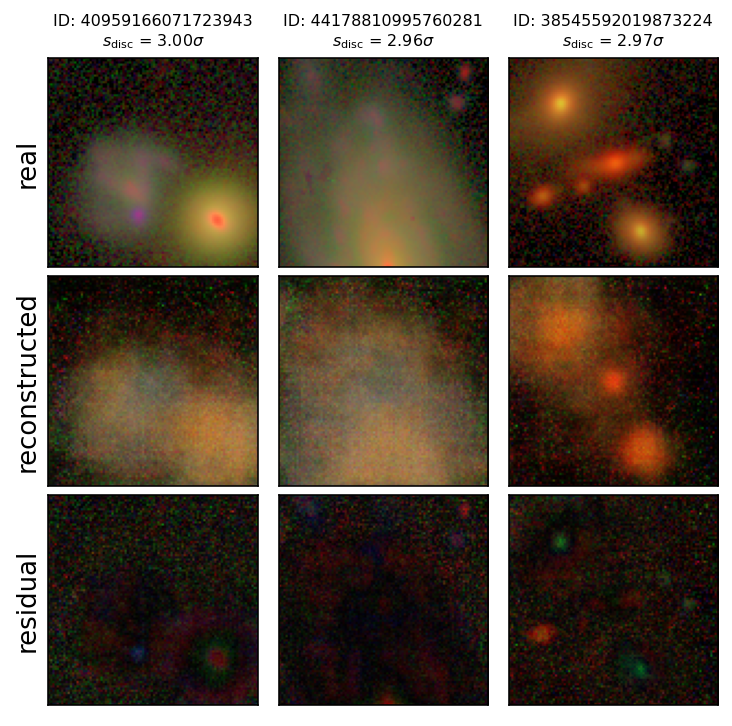

In [60]:
smin, smax = 2.5,3.5
np.random.seed(42)
indices = np.where((scores >= smin) & (scores < smax))[0] #43, 45, 39
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plotter.plot_recons(idxs_recon, imtag, tag, saveto=f'{plot_dir}/recons_{smin}to{smax}sigdisc.png')

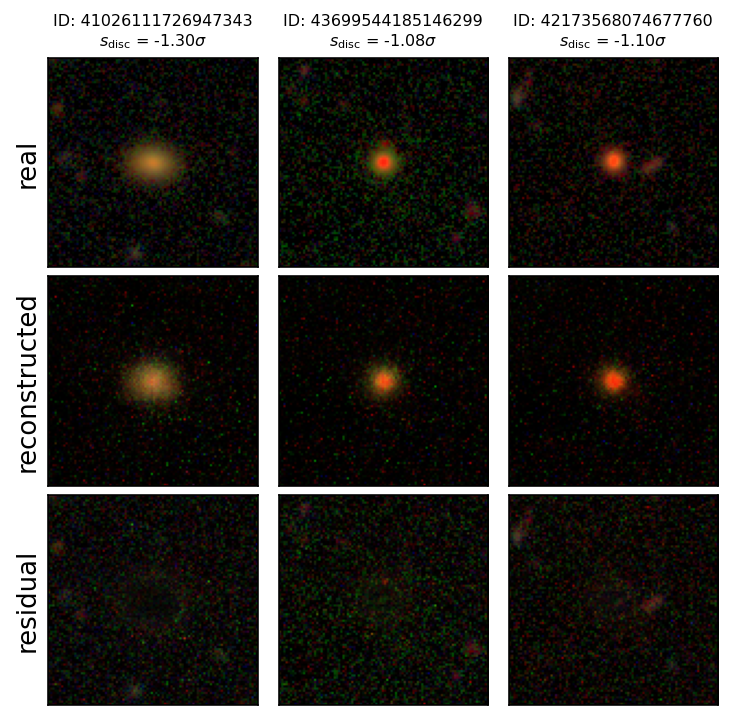

In [50]:
smin, smax = -3, -1
np.random.seed(41)
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plotter.plot_recons(idxs_recon, imtag, tag, saveto=f'{plot_dir}/recons_{smin}to{smax}sigdisc.png')

## detected anomalies

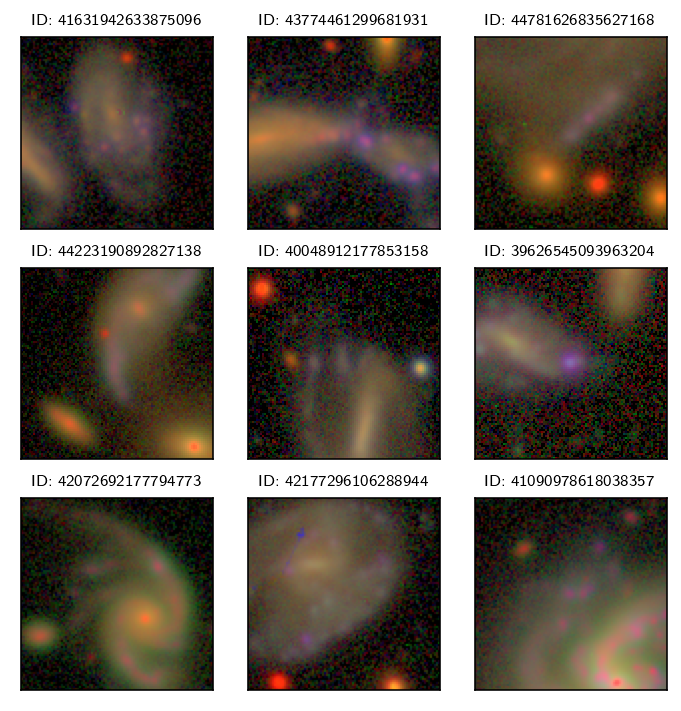

In [27]:
purple_ids = [631495, 60339, 105685, 80217, 378977, 355424, 690942, 726364, 477930]
saveto=f'{plot_dir}/anomalies_purple.png'
plotter.plot_ims(purple_ids, 3, 3, imtag='gri_lambda0.3_3sigdisc', saveto=saveto)

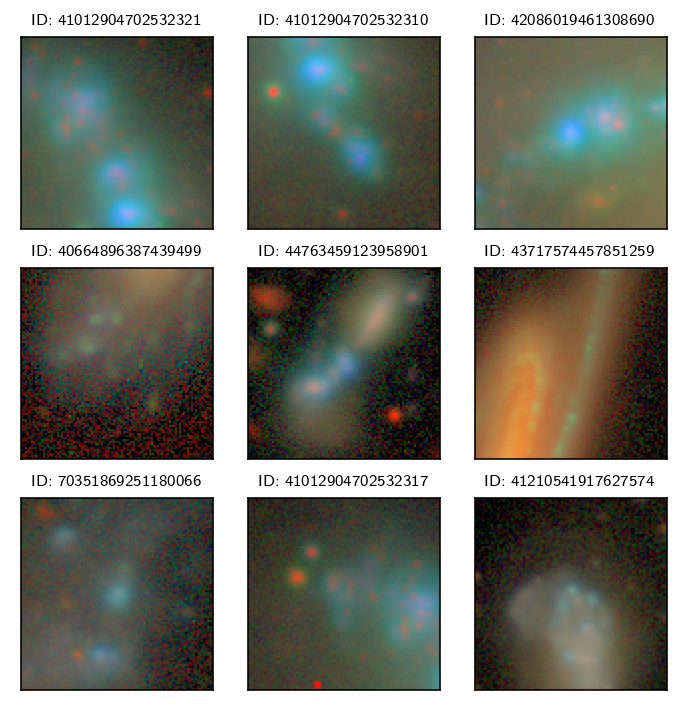

In [28]:
bluesf_ids = [461525, 461522, 702705, 402208, 86279, 27054, 207619, 461523, 554045] #54348 something close to that
saveto=f'{plot_dir}/anomalies_bluesf.png'
plotter.plot_ims(bluesf_ids, 3, 3, imtag='gri_lambda0.3_3sigdisc', saveto=saveto)

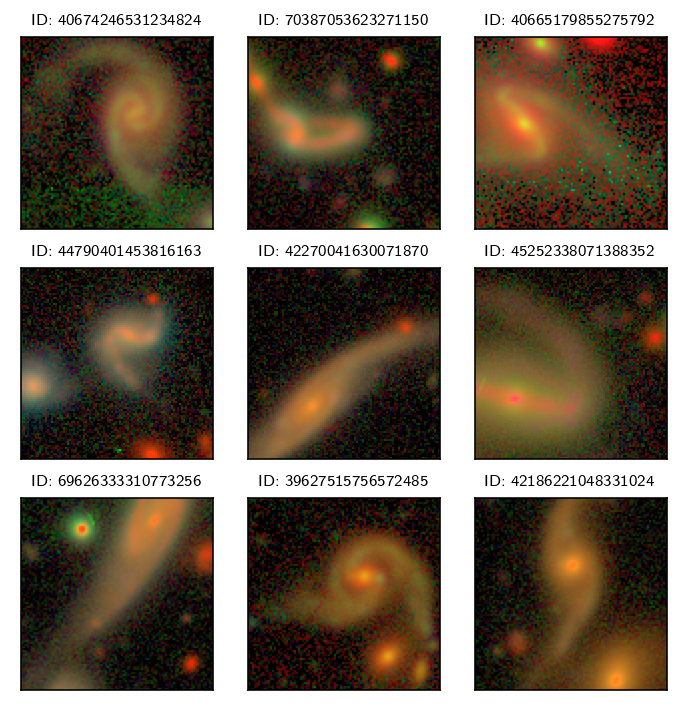

In [29]:
tidal_ids = [406992,232476,402855,112806, 771116, 116299, 193323, 357136, 734970] #390040, 526030
saveto=f'{plot_dir}/anomalies_tidal.png'
plotter.plot_ims(tidal_ids, 3, 3, imtag='gri_lambda0.3_3sigdisc', saveto=saveto)

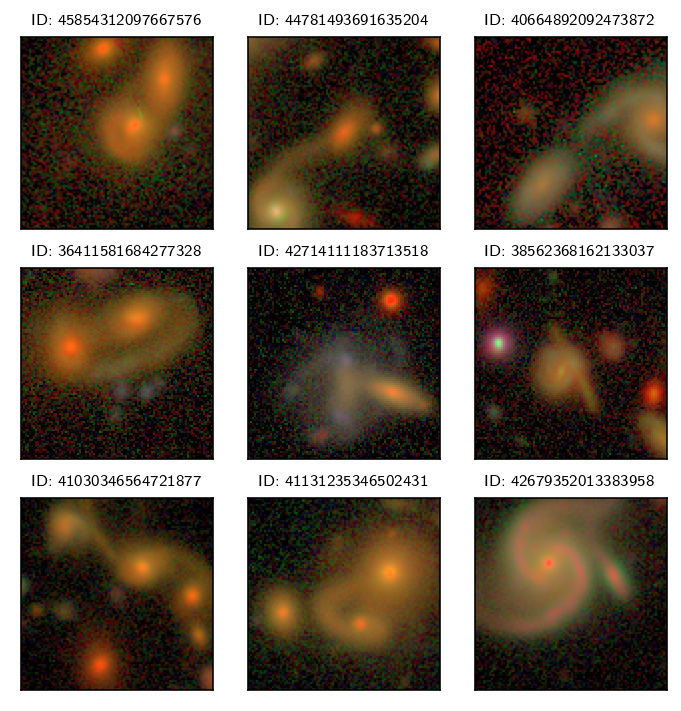

In [30]:
merger_ids = [147100,105162,402153,275917, 273903, 331753, 476493, 516719, 864590] 
saveto=f'{plot_dir}/anomalies_mergers.png'
plotter.plot_ims(merger_ids, 3, 3, imtag='gri_lambda0.3_3sigdisc', saveto=saveto)

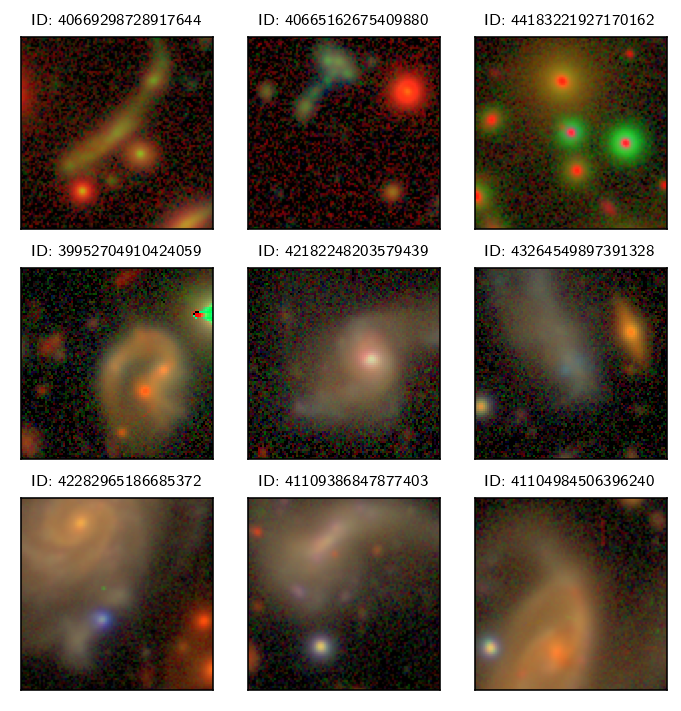

In [31]:
unknown_ids = [404340, 402594, 66001, 372063, 732308]
bluecore_ids = [941128, 782291, 494887, 490258] #585702
saveto=f'{plot_dir}/anomalies_other.png'
plotter.plot_ims(unknown_ids + bluecore_ids, 3, 3, imtag='gri_lambda0.3_3sigdisc', saveto=saveto)